# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDiscreteRepresentation
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 6

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
learning_rate = 0.0005
intermediate_epoch = 400
summary_models = SummaryModels(file_name, intermediate_epoch=intermediate_epoch, learning_rate=learning_rate)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size, zoom=zoom)
visualise_trajectories_discrete = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size,
                                                        zoom=zoom, continuous_representation=False)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories_discrete.fig_size
    visualise_trajectories_discrete.fig_size = (20,10)
    fig, ax = visualise_trajectories_discrete.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories_discrete.plot_figures
    visualise_trajectories_discrete.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map - Discrete representation
    index = df_n.iloc[idx]["Index"]
    data_set = AISDiscreteRepresentation(file_name, data_info=data_info, indicies=[index])
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=False)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    df_recon = reconstruction["Reconstruction"][1:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories_discrete.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories_discrete.plot_figures = plot_figures_tmp
    visualise_trajectories_discrete.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories_discrete.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_lr00005_400.pth


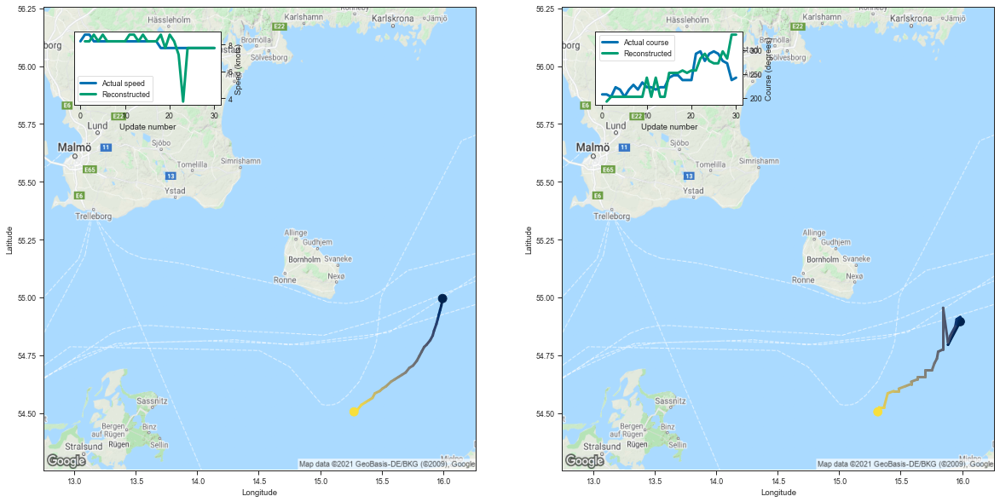

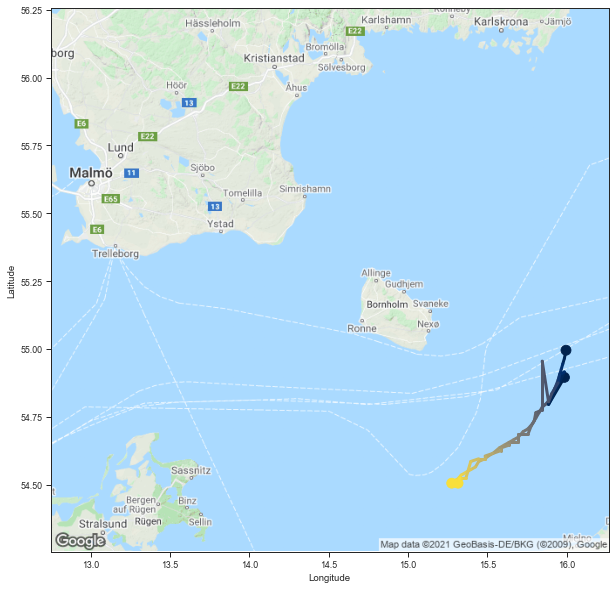

In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(95)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories_discrete.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories_discrete.plot_figures = False
visualise_trajectories_discrete.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories_discrete.plot_figures = plot_figures_tmp
visualise_trajectories_discrete.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_lr00005_400.pth


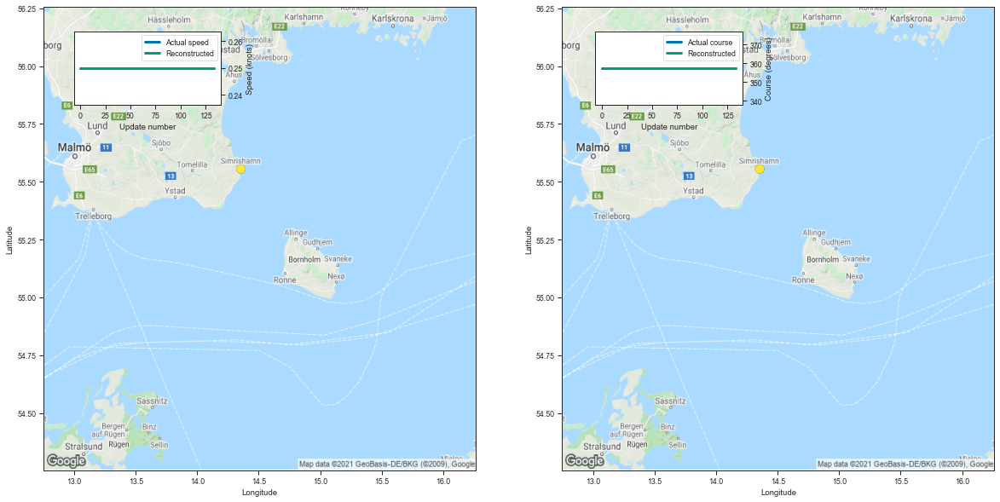

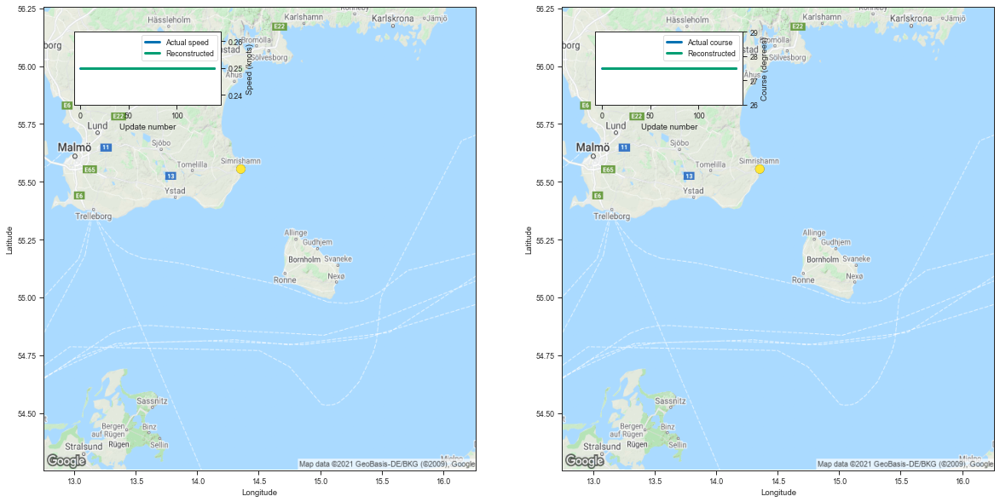

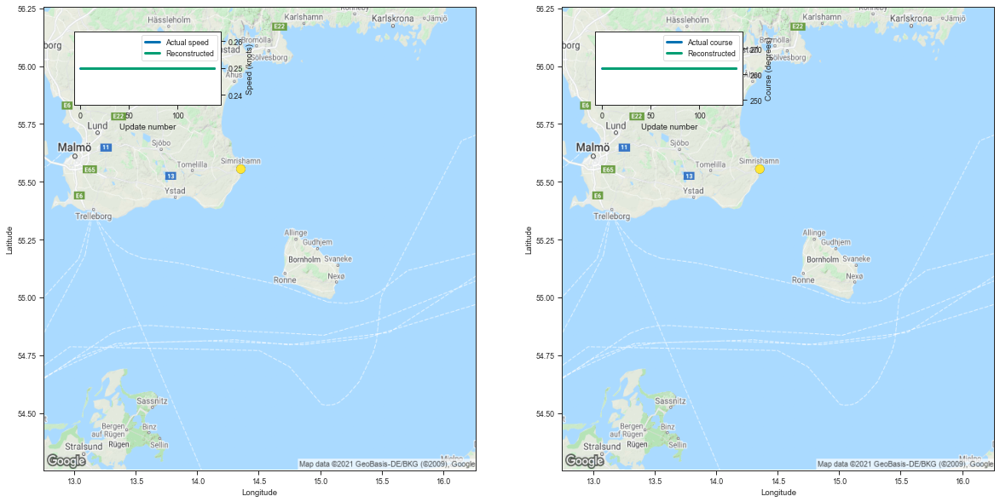

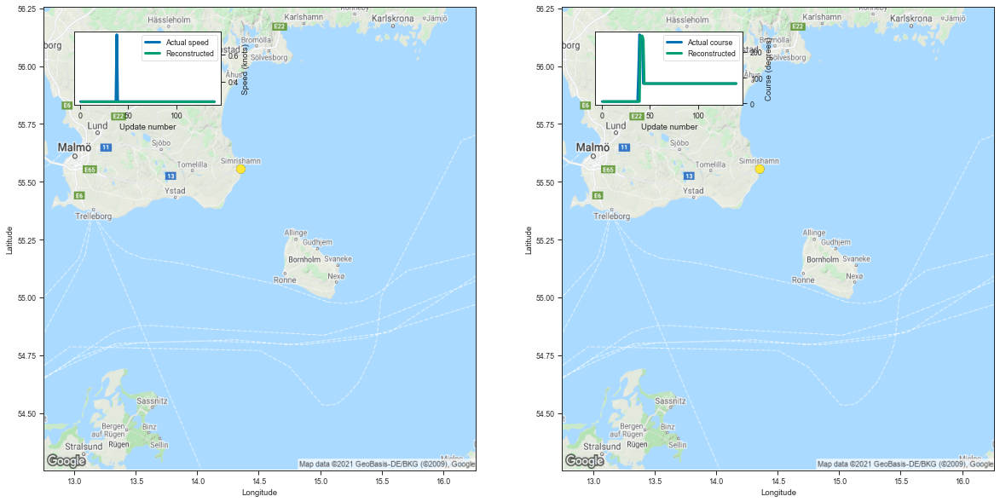

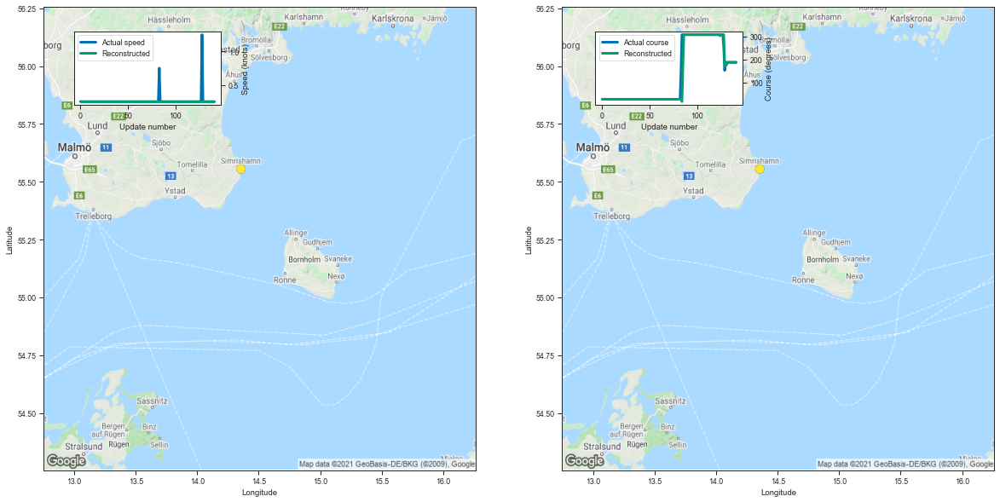

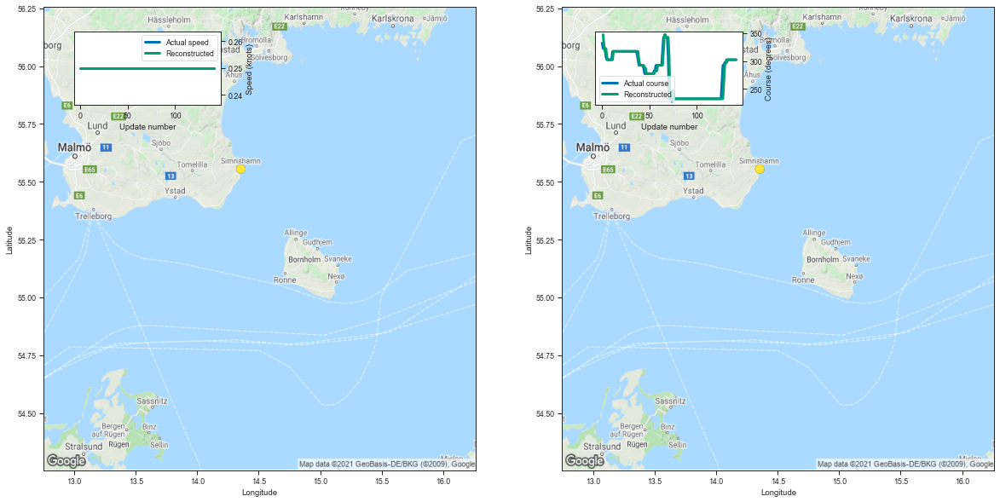

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
100,100,1583421,219021428,Fishing,135,-12.322614,-0.091279
52,52,5635000,265750000,Fishing,140,-30.693419,-0.219239
43,43,5760657,265750000,Fishing,139,-56.515141,-0.406584
85,85,6525750,265755000,Fishing,141,-100.230316,-0.710853
76,76,5480216,265750000,Fishing,142,-210.454865,-1.482077
42,42,5972813,265754000,Fishing,143,-218.138184,-1.525442


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_lr00005_400.pth


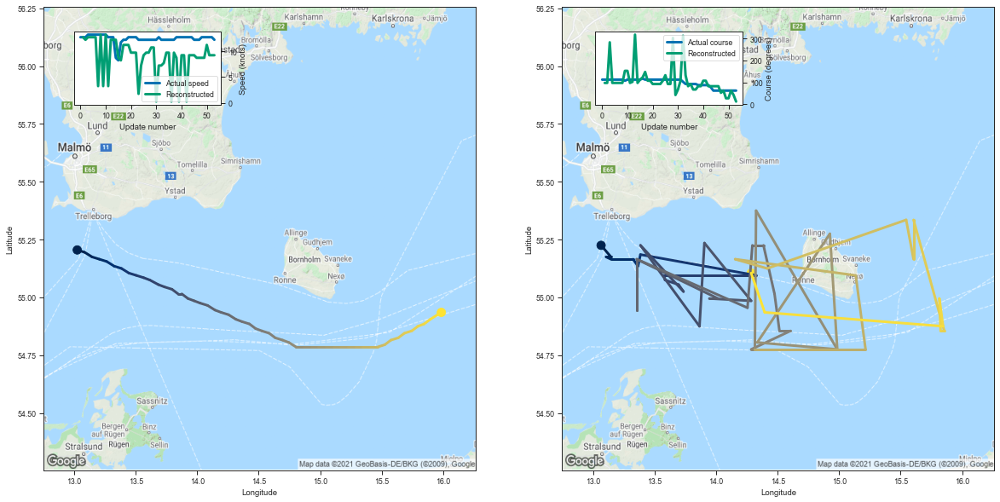

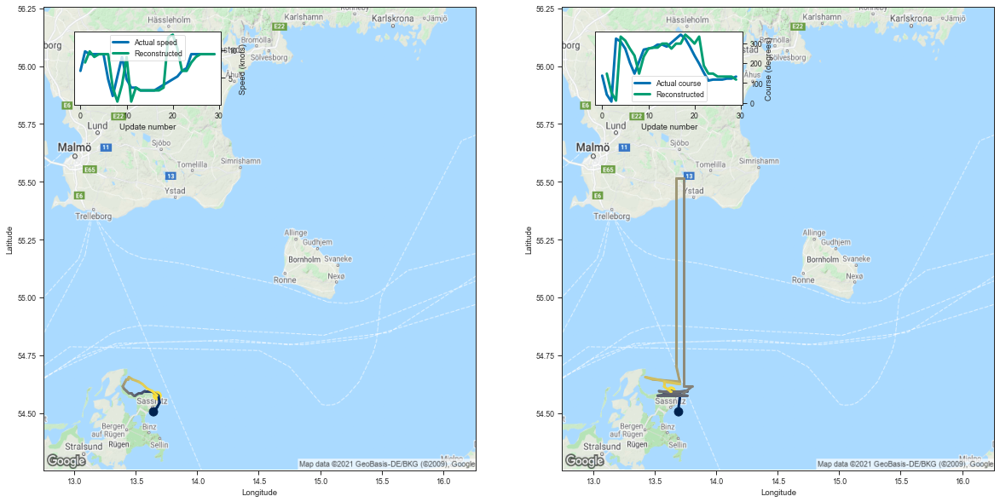

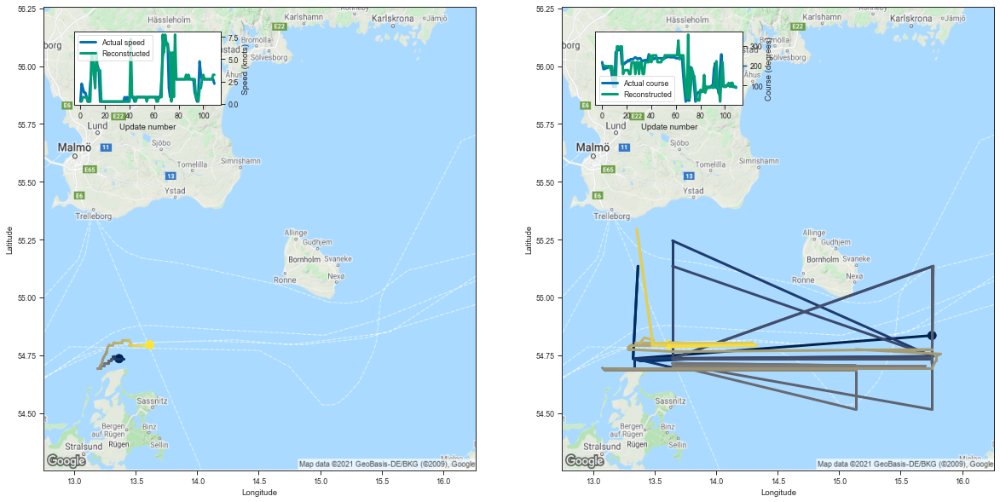

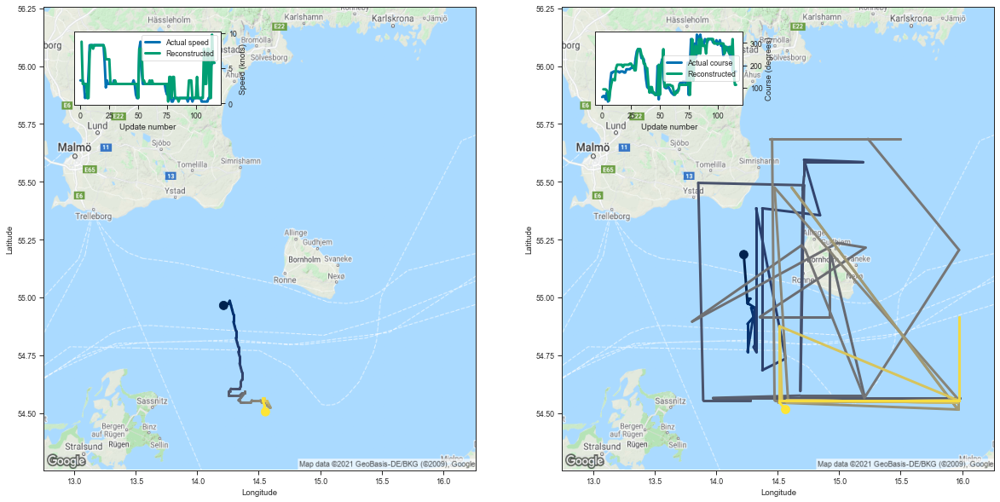

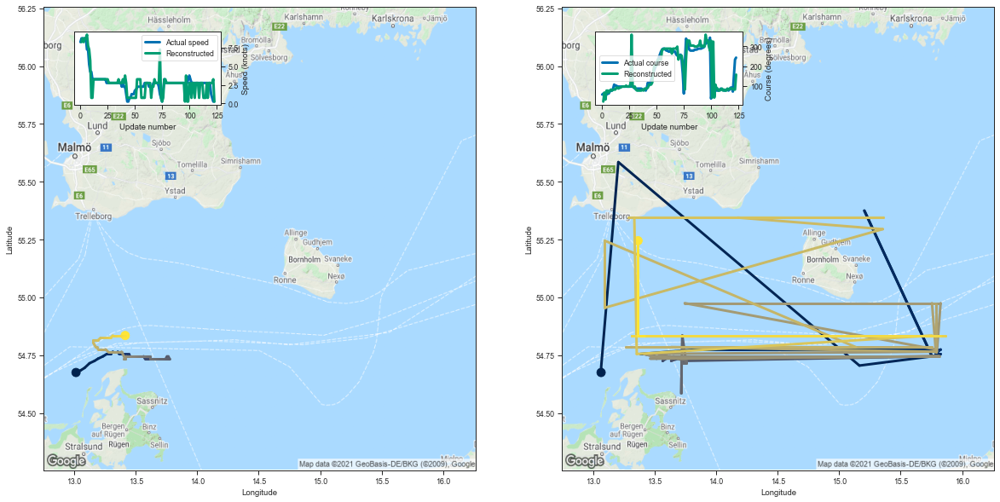

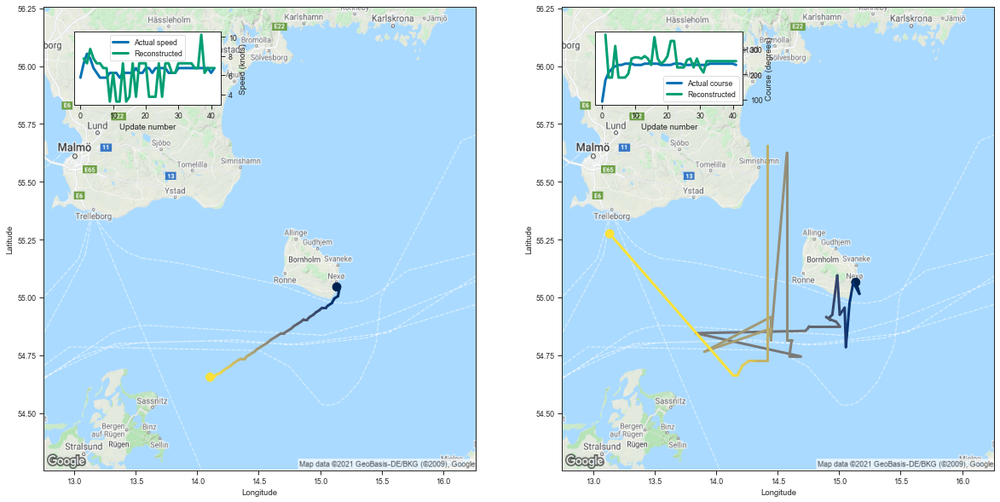

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-1309.108276,-24.242746
73,73,1113112,211542610,Fishing,30,-540.771545,-18.025718
21,21,19488,211243240,Fishing,110,-1966.326050,-17.875691
94,94,3010756,261002520,Fishing,117,-1968.524780,-16.824998
2,2,295372,211314800,Fishing,124,-2041.721436,-16.465495
24,24,1074633,211474000,Fishing,42,-684.713867,-16.302711


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_lr00005_400.pth


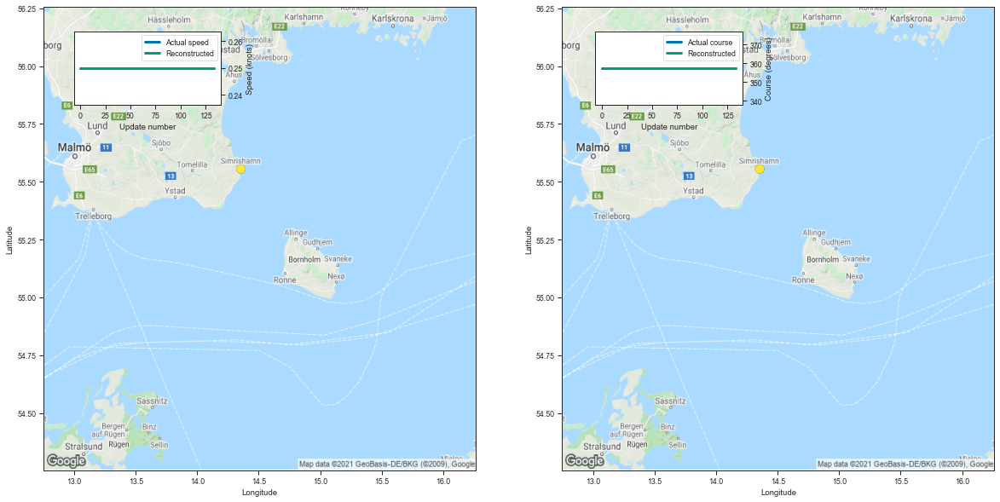

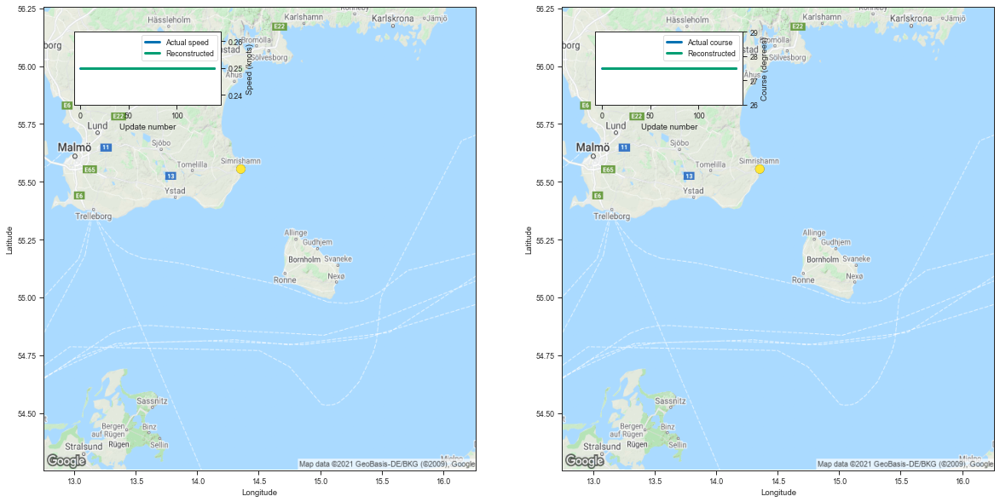

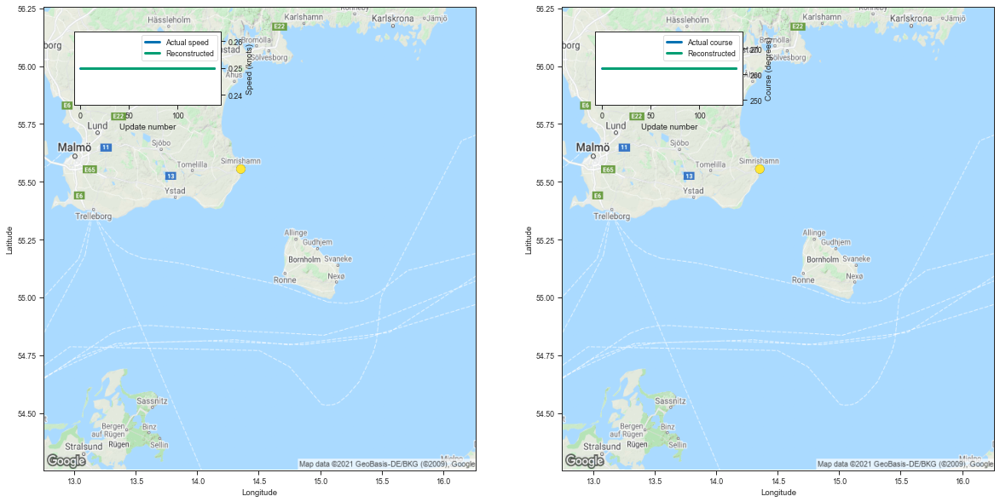

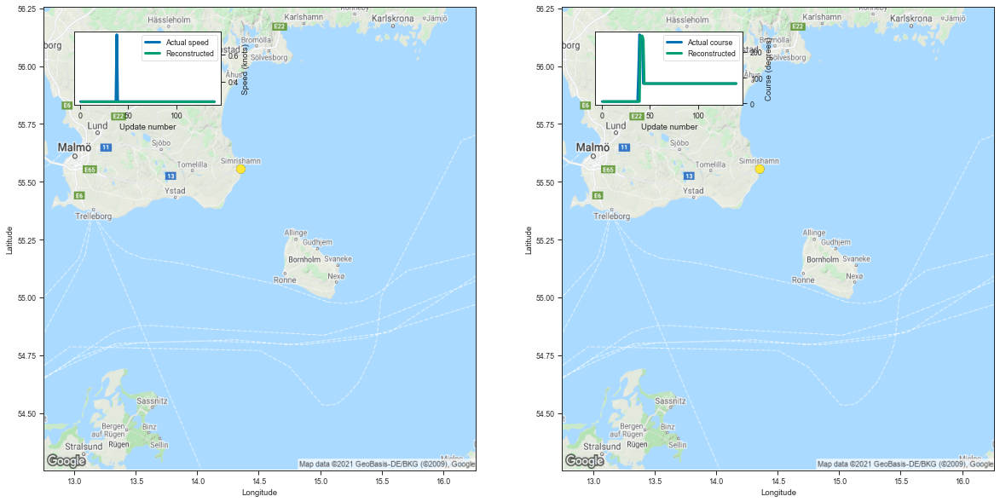

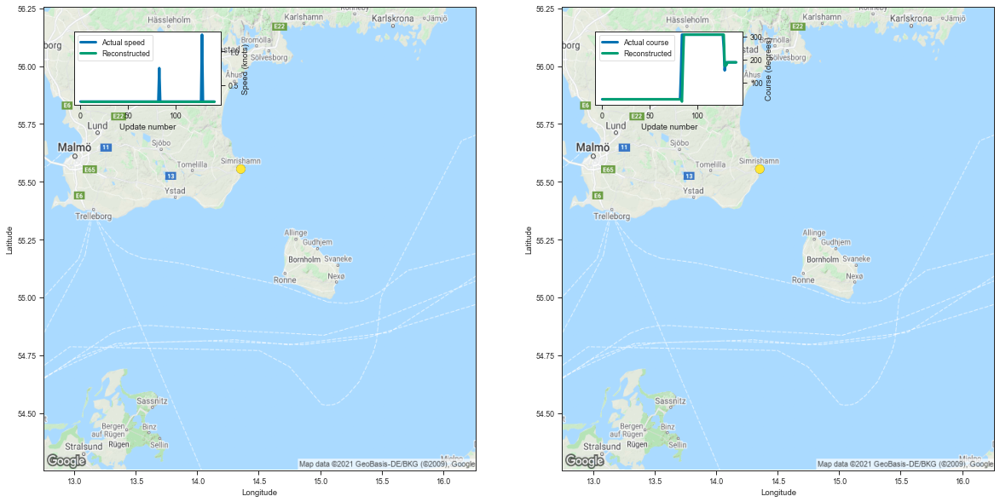

...

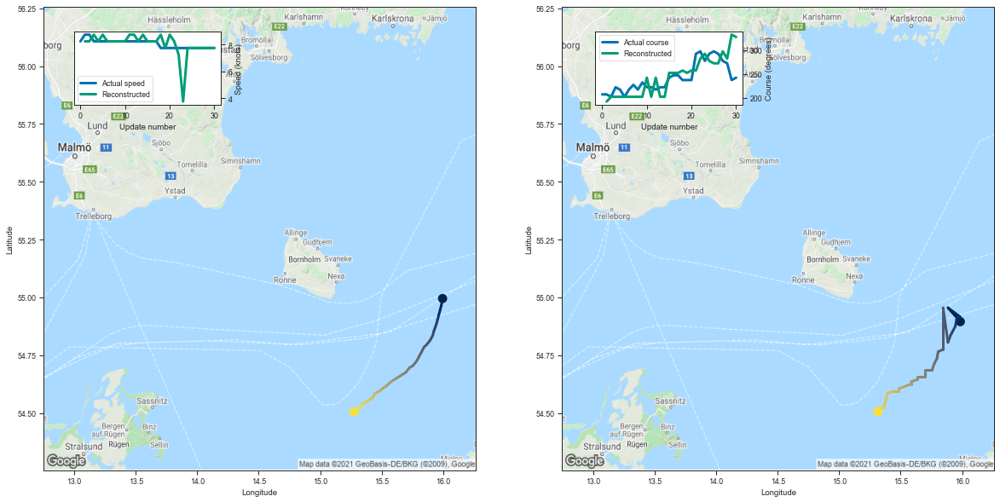

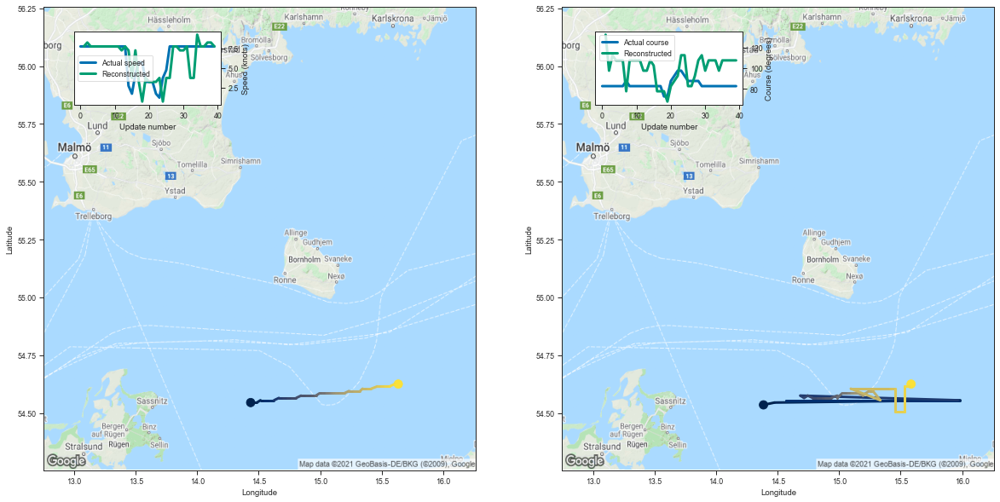

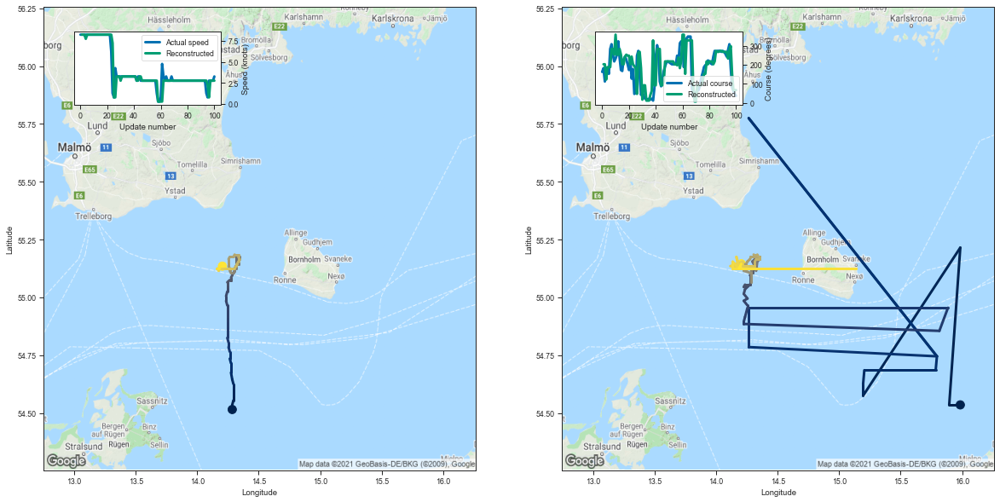

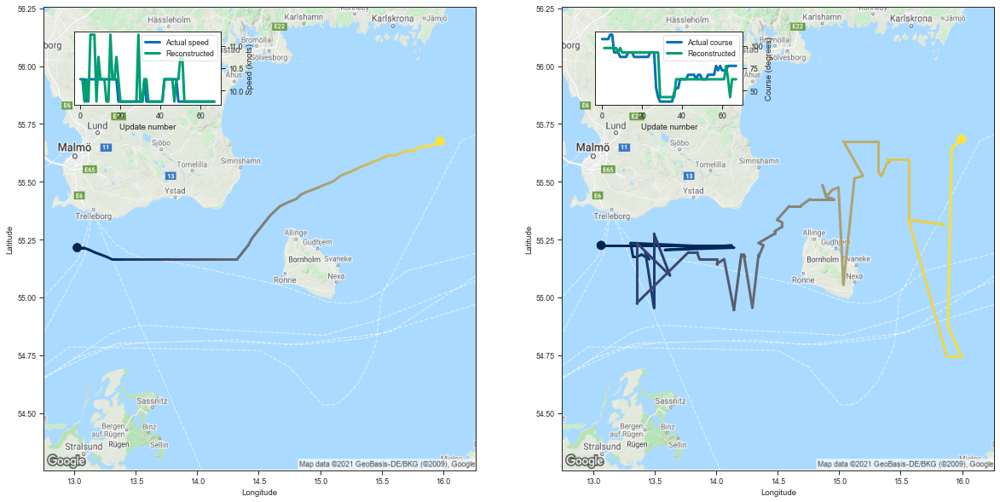

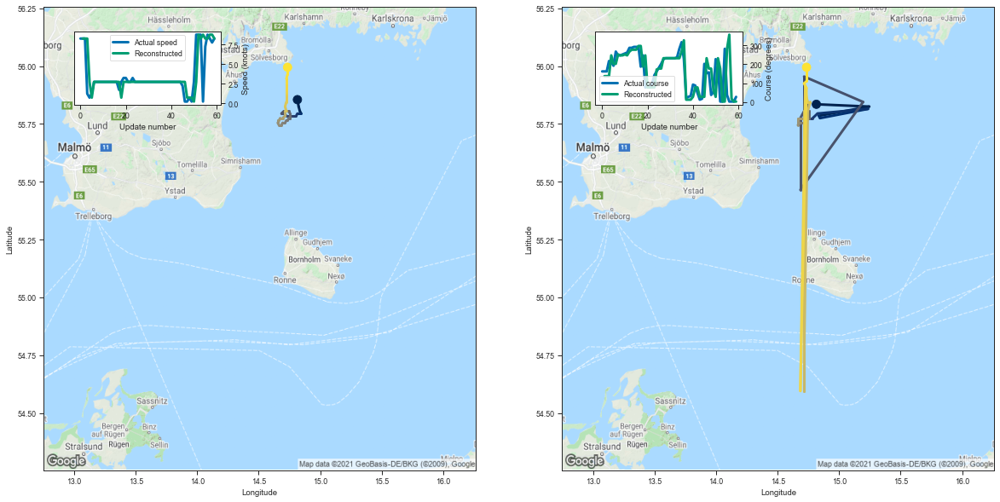

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
100,100,1583421,219021428,Fishing,135,-13.781032,-0.102082
52,52,5635000,265750000,Fishing,140,-34.140129,-0.243858
43,43,5760657,265750000,Fishing,139,-59.744259,-0.429815
85,85,6525750,265755000,Fishing,141,-103.920570,-0.737025
76,76,5480216,265750000,Fishing,142,-201.755814,-1.420816
...,...,...,...,...,...,...,...
1,1,4547326,261061000,Fishing,31,-425.617218,-13.729588
67,67,1070020,211474000,Fishing,40,-549.888062,-13.747202
48,48,4303656,261007170,Fishing,101,-1389.582275,-13.758240
97,97,7993496,273513600,Fishing,68,-961.883484,-14.145345


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
df_n